# <h1 style="font-family: Trebuchet MS; padding: 5px; font-size: 48px; color: gold; text-align: center; line-height: 1;"><b>Feature engineering<span style="color: #000000; font-size: 30px;"> rideshare </span></b></h1>


<center><a><img src="https://www.linkpicture.com/q/ridesharing-queue-management-guide-1024-8c855079d-3.webp" type='image'></a></center>

                                                                                                                  آيه عادل السيد
                                                                                                                   إسلام بن معلم
                                                                                                         عائشة محمد حسين عبد الكريم
                                                                                                                    حسن محمد





# **Introduction**

<p style="font-name: monospace; line-height: 2; font-size: 20px; font-weight: bold; letter-spacing: 2px; text-align: center;">بسم الله الرحمن الرحيم</p>


<p style="font-name: monospace; line-height: 2; font-size: 20px; font-weight: bold; letter-spacing: 2px; text-align: center;">السلام عليكم ورحمة الله وبركاته</p>

Hello, this is our project Feature engineering that we made.
In this notebook we're going to analyst rideshare and do feature engineering.

we are planning to take a closer look at features to inspect their relationships with previous features.
<a id="0"></a>


---

## **Table of Contents:**
1. [Context](#1)
2. [Import Libraries](#2)
3. [Import Data](#3)
4. [Data Understanding](#4)
5. [Data Cleaning](#5)
    1. [Removing Unwanted Columns](#6)
    2. [removing duplicate data](#7)
    3. [Handle missing values](#8)
    4. [Uniqueness Categorical Variables after cleaning](#9)
5. [Data preparation: Feature Extraction](#10)
    1. [Create 'START_DATE'](#11)
    2. [extract hours, day and month, weekday and day of week from START_DATE](#12)
    3. [create column named HourRange to group hours](#13)
6. [Feature selection 1](#14)
    1. [remove collinear variables](#14)
7. [Handling outliers](#15)
8. [Visualisation](#16)
    1. [Distribution of Features](#17)
    2. [Distribution of hourRange](#18)
    3. [Percentage count of source](#19)
    4. [The average price by distance](#20)
    5. [Distubition of price in each cab_type](#21)
    6. [Percentage count of categorical variables](#22)
    7. [Number of trips vs months](#23)
    8. [Number of trips vs days](#24)
    9. [Number of trips vs days of december](#25)
    10. [Distribution of trips per day](#26)
    11. [Pickup points vs frequency](#27)
    12. [End points vs frequency](#28)
    13. [distribution of uber caps](#29)
9. [Convert all categorical to numerical](#30)
10. [Feature selection 2](#31)
11. [Dimension Reduction](#32)
12. [Modeling](#33)

<a id="1"></a>

---

# **Context**

Feature engineering is the process of selecting, manipulating, and transforming
raw data into features that can be used in supervised learning. In order to make machine learning work well on
new tasks, it might be necessary to design and train better features

---

## **Content**
the data contains 57 features at first with 693071 rows

---

## **Target**
A ridesharing  is a company that, via websites and mobile apps, matches passengers with drivers of
vehicles . 

The target is to analyse and to know how the price varies according to features.

---

## **Task:**
- قراءة و تحليل البيانات
- القيام بكل خطوات تنظيف البيانات المطلوبة
- استخدام كل الأدوات التي تري انها مطلوبة من علم FE بما بفيدك
- عمل visualization  المناسبة من البيانات
-تحديد ال outliers  و حذفها بما تراه مناسبا
- عمل  feature extraction  لو تواجدت
- عمل feature selection  بالطريقة التي تراها مناسبة


<a id="2"></a>
*Let's get started...*

-----------
# <center><font size = 6><span style="color:#2a6592">Import Libraries</span></font></center>

[back to table of Contents](#0)

In [1]:
import pandas as pd
import numpy as np
import datetime
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import calendar
import datetime
import warnings
warnings.filterwarnings('ignore')
from matplotlib import style

<a id="3"></a>

<a id="3"></a>

-----------
# <center><font size = 6><span style="color:#2a6592">Import Data</span></font></center>


[back to table of Contents](#0)

In [2]:
pd.set_option('display.max_columns', None)
data = pd.read_csv('rideshare_kaggle.csv')
data.head() 

,id,timestamp,hour,day,month,datetime,timezone,source,destination,cab_type,product_id,name,price,distance,surge_multiplier,latitude,longitude,temperature,apparentTemperature,short_summary,long_summary,precipIntensity,precipProbability,humidity,windSpeed,windGust,windGustTime,visibility,temperatureHigh,temperatureHighTime,temperatureLow,temperatureLowTime,apparentTemperatureHigh,apparentTemperatureHighTime,apparentTemperatureLow,apparentTemperatureLowTime,icon,dewPoint,pressure,windBearing,cloudCover,uvIndex,visibility.1,ozone,sunriseTime,sunsetTime,moonPhase,precipIntensityMax,uvIndexTime,temperatureMin,temperatureMinTime,temperatureMax,temperatureMaxTime,apparentTemperatureMin,apparentTemperatureMinTime,apparentTemperatureMax,apparentTemperatureMaxTime
0,424553bb-7174-41ea-aeb4-fe06d4f4b9d7,1.544953e+09,9,16,12,2018-12-16 09:30:07,America/New_York,Haymarket Square,North Station,Lyft,lyft_line,Shared,5.0,0.44,1.0,42.2148,-71.033,42.34,37.12,Mostly Cloudy,Rain throughout the day.,0.0000,0.0,0.68,8.66,9.17,1545015600,10.000,43.68,1544968800,34.19,1545048000,37.95,1544968800,27.39,1545044400,partly-cloudy-night,32.70,1021.98,57,0.72,0,10.000,303.8,1544962084,1544994864,0.30,0.1276,1544979600,39.89,1545012000,43.68,1544968800,33.73,1545012000,38.07,1544958000
1,4bd23055-6827-41c6-b23b-3c491f24e74d,1.543284e+09,2,27,11,2018-11-27 02:00:23,America/New_York,Haymarket Square,North Station,Lyft,lyft_premier,Lux,11.0,0.44,1.0,42.2148,-71.033,43.58,37.35,Rain,"Rain until morning, starting again in the eve...",0.1299,1.0,0.94,11.98,11.98,1543291200,4.786,47.30,1543251600,42.10,1543298400,43.92,1543251600,36.20,1543291200,rain,41.83,1003.97,90,1.00,0,4.786,291.1,1543232969,1543266992,0.64,0.1300,1543251600,40.49,1543233600,47.30,1543251600,36.20,1543291200,43.92,1543251600
2,981a3613-77af-4620-a42a-0c0866077d1e,1.543367e+09,1,28,11,2018-11-28 01:00:22,America/New_York,Haymarket Square,North Station,Lyft,lyft,Lyft,7.0,0.44,1.0,42.2148,-71.033,38.33,32.93,Clear,Light rain in the morning.,0.0000,0.0,0.75,7.33,7.33,1543334400,10.000,47.55,1543320000,33.10,1543402800,44.12,1543320000,29.11,1543392000,clear-night,31.10,992.28,240,0.03,0,10.000,315.7,1543319437,1543353364,0.68,0.1064,1543338000,35.36,1543377600,47.55,1543320000,31.04,1543377600,44.12,1543320000
3,c2d88af2-d278-4bfd-a8d0-29ca77cc5512,1.543554e+09,4,30,11,2018-11-30 04:53:02,America/New_York,Haymarket Square,North Station,Lyft,lyft_luxsuv,Lux Black XL,26.0,0.44,1.0,42.2148,-71.033,34.38,29.63,Clear,Partly cloudy throughout the day.,0.0000,0.0,0.73,5.28,5.28,1543514400,10.000,45.03,1543510800,28.90,1543579200,38.53,1543510800,26.20,1543575600,clear-night,26.64,1013.73,310,0.00,0,10.000,291.1,1543492370,1543526114,0.75,0.0000,1543507200,34.67,1543550400,45.03,1543510800,30.30,1543550400,38.53,1543510800
4,e0126e1f-8ca9-4f2e-82b3-50505a09db9a,1.543463e+09,3,29,11,2018-11-29 03:49:20,America/New_York,Haymarket Square,North Station,Lyft,lyft_plus,Lyft XL,9.0,0.44,1.0,42.2148,-71.033,37.44,30.88,Partly Cloudy,Mostly cloudy throughout the day.,0.0000,0.0,0.70,9.14,9.14,1543446000,10.000,42.18,1543420800,36.71,1543478400,35.75,1543420800,30.29,1543460400,partly-cloudy-night,28.61,998.36,303,0.44,0,10.000,347.7,1543405904,1543439738,0.72,0.0001,1543420800,33.10,1543402800,42.18,1543420800,29.11,1543392000,35.75,1543420800


<a id="4"></a>

 
----------
# <center><font size = 6><span style="color:#2a6592">Data Uderstanding</span></font></center>


[back to table of Contents](#0)

In [3]:
data.shape

(693071, 57)

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 693071 entries, 0 to 693070
Data columns (total 57 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   id                           693071 non-null  object 
 1   timestamp                    693071 non-null  float64
 2   hour                         693071 non-null  int64  
 3   day                          693071 non-null  int64  
 4   month                        693071 non-null  int64  
 5   datetime                     693071 non-null  object 
 6   timezone                     693071 non-null  object 
 7   source                       693071 non-null  object 
 8   destination                  693071 non-null  object 
 9   cab_type                     693071 non-null  object 
 10  product_id                   693071 non-null  object 
 11  name                         693071 non-null  object 
 12  price                        637976 non-null  float64
 13 

In [5]:
numerical = data.select_dtypes(['int64', 'float64']).columns # getting the Uniqueness numerical variable
categorical = data.select_dtypes(['category', 'object']).columns # getting the Uniqueness catrgorical variable
for col in categorical:
    print('{} : {} unique value(s)'.format(col, data[col].nunique()))

id : 693071 unique value(s)
datetime : 31350 unique value(s)
timezone : 1 unique value(s)
source : 12 unique value(s)
destination : 12 unique value(s)
cab_type : 2 unique value(s)
product_id : 13 unique value(s)
name : 13 unique value(s)
short_summary : 9 unique value(s)
long_summary : 11 unique value(s)
icon : 7 unique value(s)


<a id="5"></a>

-------
# <center><font size = 6><span style="color:#2a6592">Data Cleaning</span></font></center>

[back to table of Contents](#0)

* *Removing Unwanted Columns*
* *removing duplicate data*
* *Handle missing values*
* *Uniqueness Categorical Variables*

<a id="6"></a>
**Removing Unwanted Columns**

In [6]:
data.nunique()

id                             693071
timestamp                       36179
hour                               24
day                                17
month                               2
datetime                        31350
timezone                            1
source                             12
destination                        12
cab_type                            2
product_id                         13
name                               13
price                             147
distance                          549
surge_multiplier                    7
latitude                           11
longitude                          12
temperature                       308
apparentTemperature               319
short_summary                       9
long_summary                       11
precipIntensity                    63
precipProbability                  29
humidity                           51
windSpeed                         291
windGust                          286
windGustTime

In [7]:
data = data.drop(columns = ['id','timestamp','timezone',"product_id"])

<a id="7"></a>

**removing duplicate data**

In [8]:
data.duplicated().sum()

1493

In [9]:
# Rows containing duplicate data
duplicate_rows_data = data[data.duplicated()]
print("number of duplicate rows:", duplicate_rows_data.shape)

number of duplicate rows: (1493, 53)


In [10]:
data=data.drop_duplicates()
data.shape

(691578, 53)

<a id="8"></a>

**Handle missing values**

In [11]:
#checking for duplicates
print(data.isna().sum())

hour                               0
day                                0
month                              0
datetime                           0
source                             0
destination                        0
cab_type                           0
name                               0
price                          54542
distance                           0
surge_multiplier                   0
latitude                           0
longitude                          0
temperature                        0
apparentTemperature                0
short_summary                      0
long_summary                       0
precipIntensity                    0
precipProbability                  0
humidity                           0
windSpeed                          0
windGust                           0
windGustTime                       0
visibility                         0
temperatureHigh                    0
temperatureHighTime                0
temperatureLow                     0
t

In [12]:
data=data.dropna()

In [13]:
print(data.isna().sum())

hour                           0
day                            0
month                          0
datetime                       0
source                         0
destination                    0
cab_type                       0
name                           0
price                          0
distance                       0
surge_multiplier               0
latitude                       0
longitude                      0
temperature                    0
apparentTemperature            0
short_summary                  0
long_summary                   0
precipIntensity                0
precipProbability              0
humidity                       0
windSpeed                      0
windGust                       0
windGustTime                   0
visibility                     0
temperatureHigh                0
temperatureHighTime            0
temperatureLow                 0
temperatureLowTime             0
apparentTemperatureHigh        0
apparentTemperatureHighTime    0
apparentTe

<a id="9"></a>

### **Uniqueness Categorical Variables after cleaning data**

In [14]:
numerical = data.select_dtypes(['int64', 'float64']).columns # getting the Uniqueness numerical variable
categorical = data.select_dtypes(['category', 'object']).columns # getting the Uniqueness catrgorical variable
for col in categorical:
    print('{} : {} unique value(s)'.format(col, data[col].nunique()))

datetime : 31350 unique value(s)
source : 12 unique value(s)
destination : 12 unique value(s)
cab_type : 2 unique value(s)
name : 12 unique value(s)
short_summary : 9 unique value(s)
long_summary : 11 unique value(s)
icon : 7 unique value(s)


<a id="10"></a>

--------------
# <center><font size = 6><span style="color:#2a6592">Data preparation: Feature Extraction</span></font></center>

[back to table of Contents](#0)

* *Create 'START_DATE'*
* *extract hours, day and month, weekday and day of week from START_DATE*
* *create column named HourRange to group hours*

<a id="11"></a>

**Create 'START_DATE'**

In [15]:
data['START_DATE']=pd.to_datetime(data['datetime'], format='%Y/%m/%d %H:%M')

<a id="12"></a>

**extract hours, day and month, weekday and day of week from START_DATE**

In [16]:
data['HOURS']=[x.hour for x in data['START_DATE']]
data['DAY']=[x.day for x in data['START_DATE']]
data['MONTH']=[x.month for x in data['START_DATE']]
data['WEEKDAY']=[calendar.day_name[x.day_of_week] for x in data['START_DATE']]
data['DAY_OF_WEEK']=[x.day_of_week for x in data['START_DATE']]

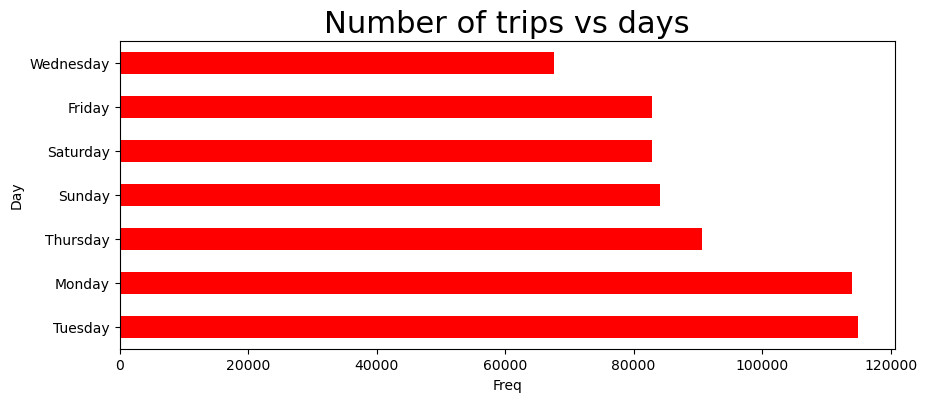

In [17]:
# To analyze the day of the week data, need to generate the names of days from the timestamp
day_week = [calendar.day_name[x.dayofweek] for x in 
            pd.to_datetime(data['datetime'], format='%Y/%m/%d %H:%M:%S')]
day_week=pd.Series(day_week)

days=day_week.value_counts()
days.plot(kind='barh',color='red', figsize=(10,4))
plt.xlabel('Freq')
plt.ylabel('Day')
plt.title('Number of trips vs days',fontsize=22)
plt.show()

<a id="13"></a>

**create column named HourRange to group hours**

In [18]:
data['hourRange'] = data.hour.apply(
               lambda x: ('0 - 3 am' if 0<=x <= 3 else (
                   '4 - 7 am' if 4<=x <= 7 else ('8 - 11 pm' if 8<=x <= 11 else (
               '12 - 15 pm' if 12<=x <= 15 else (
               '16 - 19 pm' if 16<=x <= 19 else (
               '20 - 23 pm' if 20<=x <= 23 else 'missed')))))))

In [19]:
data.head(3)

,hour,day,month,datetime,source,destination,cab_type,name,price,distance,surge_multiplier,latitude,longitude,temperature,apparentTemperature,short_summary,long_summary,precipIntensity,precipProbability,humidity,windSpeed,windGust,windGustTime,visibility,temperatureHigh,temperatureHighTime,temperatureLow,temperatureLowTime,apparentTemperatureHigh,apparentTemperatureHighTime,apparentTemperatureLow,apparentTemperatureLowTime,icon,dewPoint,pressure,windBearing,cloudCover,uvIndex,visibility.1,ozone,sunriseTime,sunsetTime,moonPhase,precipIntensityMax,uvIndexTime,temperatureMin,temperatureMinTime,temperatureMax,temperatureMaxTime,apparentTemperatureMin,apparentTemperatureMinTime,apparentTemperatureMax,apparentTemperatureMaxTime,START_DATE,HOURS,DAY,MONTH,WEEKDAY,DAY_OF_WEEK,hourRange
0,9,16,12,2018-12-16 09:30:07,Haymarket Square,North Station,Lyft,Shared,5.0,0.44,1.0,42.2148,-71.033,42.34,37.12,Mostly Cloudy,Rain throughout the day.,0.0000,0.0,0.68,8.66,9.17,1545015600,10.000,43.68,1544968800,34.19,1545048000,37.95,1544968800,27.39,1545044400,partly-cloudy-night,32.70,1021.98,57,0.72,0,10.000,303.8,1544962084,1544994864,0.30,0.1276,1544979600,39.89,1545012000,43.68,1544968800,33.73,1545012000,38.07,1544958000,2018-12-16 09:30:07,9,16,12,Sunday,6,8 - 11 pm
1,2,27,11,2018-11-27 02:00:23,Haymarket Square,North Station,Lyft,Lux,11.0,0.44,1.0,42.2148,-71.033,43.58,37.35,Rain,"Rain until morning, starting again in the eve...",0.1299,1.0,0.94,11.98,11.98,1543291200,4.786,47.30,1543251600,42.10,1543298400,43.92,1543251600,36.20,1543291200,rain,41.83,1003.97,90,1.00,0,4.786,291.1,1543232969,1543266992,0.64,0.1300,1543251600,40.49,1543233600,47.30,1543251600,36.20,1543291200,43.92,1543251600,2018-11-27 02:00:23,2,27,11,Tuesday,1,0 - 3 am
2,1,28,11,2018-11-28 01:00:22,Haymarket Square,North Station,Lyft,Lyft,7.0,0.44,1.0,42.2148,-71.033,38.33,32.93,Clear,Light rain in the morning.,0.0000,0.0,0.75,7.33,7.33,1543334400,10.000,47.55,1543320000,33.10,1543402800,44.12,1543320000,29.11,1543392000,clear-night,31.10,992.28,240,0.03,0,10.000,315.7,1543319437,1543353364,0.68,0.1064,1543338000,35.36,1543377600,47.55,1543320000,31.04,1543377600,44.12,1543320000,2018-11-28 01:00:22,1,28,11,Wednesday,2,0 - 3 am


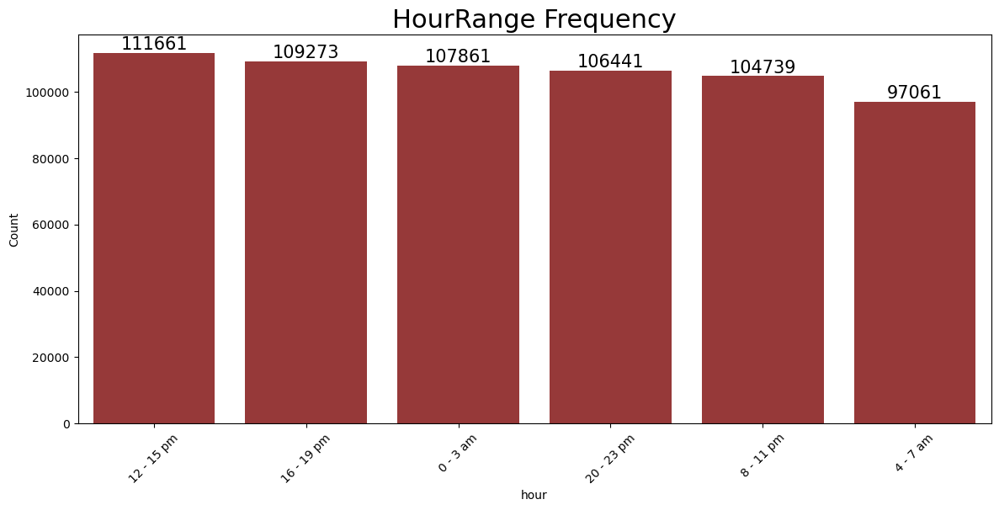

In [20]:
def top_rating_plot(df,column, n):
    #plotting graph
    plt.figure(figsize=(14,6))
    data = df[str(column)].value_counts().head(n)
    ax = sns.barplot(x = data.index, y = data, order= data.index, color='brown')
    for p in ax.patches:
        ax.text(p.get_x() + p.get_width()/2., p.get_height(), '%d' % int(p.get_height()), 
                fontsize=15, ha='center', va='bottom')
    plt.title('HourRange Frequency', fontsize=22)
    plt.xlabel('hour')
    plt.ylabel('Count')
    plt.xticks(rotation=45)
    plt.show()

top_rating_plot(data,'hourRange',10)

<a id="14"></a>

------- 

# <center><font size = 6><span style="color:#2a6592">feature Selection</span></font></center>

[back](#0)

**remove collinear variables**

In [21]:
numerical = data.select_dtypes(['int64', 'float64']).columns 

In [22]:
# Threshold for removing correlated variables
threshold = 0.9
# Absolute value correlation matrix
corr_matrix = data.corr().abs()
# Upper triangle of correlations
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
# Select columns with correlations above threshold
to_drop = [column for column in upper.columns if any(upper[column] > threshold)]

print('There are %d columns to remove.' % (len(to_drop)))
to_drop

There are 22 columns to remove.


['apparentTemperature',
 'windGust',
 'temperatureHighTime',
 'temperatureLowTime',
 'apparentTemperatureHigh',
 'apparentTemperatureHighTime',
 'apparentTemperatureLow',
 'apparentTemperatureLowTime',
 'visibility.1',
 'sunriseTime',
 'sunsetTime',
 'uvIndexTime',
 'temperatureMinTime',
 'temperatureMax',
 'temperatureMaxTime',
 'apparentTemperatureMin',
 'apparentTemperatureMinTime',
 'apparentTemperatureMax',
 'apparentTemperatureMaxTime',
 'HOURS',
 'DAY',
 'MONTH']

In [23]:
data = data.drop(columns = to_drop)
print('data shape after removing collinear vaiables: ', data.shape)

data shape after removing collinear vaiables:  (637036, 38)


<a id="15"></a>

-------------
# <center><font size = 6><span style="color:#2a6592">Handling ouliers</span></font></center>

[back to table of Contents](#0)

In [24]:
# ouliers
def ouliers(col):
    global col_out
    Q3 = data[col].quantile(0.75)
    Q1 = data[col].quantile(0.25)
    IQR = Q3 - Q1
    upper_limit=Q3+(IQR*1.5)
    lower_limit = Q1 - (IQR * 1.5)
    df1=data[ (data[col] > upper_limit) | (data[col] < lower_limit)] 
    data.loc[ (data[col] > upper_limit) | (data[col] < lower_limit),col]=np.nan
    if df1.shape[0]!=0:
        print(col," : ",df1.shape)
        print("----------------------------")
        col_out.append(col)
    return col_out,df1.shape[0]

In [25]:
numerical = data.select_dtypes(['int64', 'float64']).columns # getting the Uniqueness catrgorical variable
print("""number of ouliers for each column""")
print("----------------------------")
l=[]
col_out=[]
for col in numerical:
    #print('{} : {} unique value(s)'.format(col, data[col].nunique()))
    col_out,val=ouliers(col)
    l.append(val)

number of ouliers for each column
----------------------------
price  :  (5589, 38)
----------------------------
distance  :  (7205, 38)
----------------------------
surge_multiplier  :  (20975, 38)
----------------------------
latitude  :  (81448, 38)
----------------------------
temperature  :  (33707, 38)
----------------------------
precipIntensity  :  (138505, 38)
----------------------------
precipProbability  :  (138505, 38)
----------------------------
visibility  :  (125628, 38)
----------------------------
temperatureHigh  :  (150681, 38)
----------------------------
dewPoint  :  (34294, 38)
----------------------------
uvIndex  :  (146579, 38)
----------------------------
temperatureMin  :  (4052, 38)
----------------------------


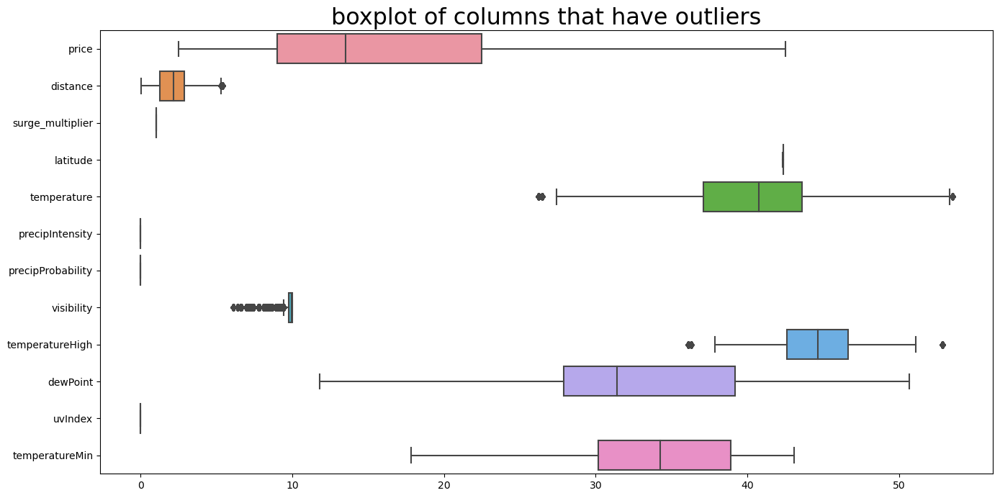

In [26]:
plt.figure(figsize=(16,8))
plt.title("boxplot of columns that have outliers", fontsize = 23)
sns.boxplot(data=data[['price','distance','surge_multiplier','latitude','temperature','precipIntensity','precipProbability','visibility','temperatureHigh','dewPoint','uvIndex','temperatureMin']], orient="h")
plt.show()

In [27]:
print("number of column that have ouliers are : ", len(col_out))
print("number of column that doesn't have ouliers are : ", len(numerical)-len(col_out))

number of column that have ouliers are :  12
number of column that doesn't have ouliers are :  15


In [28]:
l=list(filter(lambda num: num != 0, l))
l=[i/data.shape[0] for i in l]

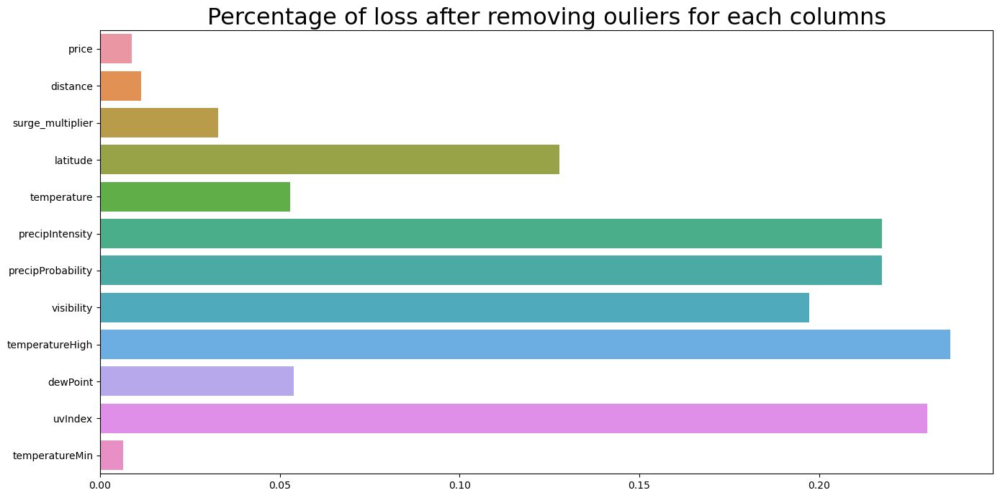

In [29]:
plt.figure(figsize=(16,8))
sns.barplot(x=l, y=col_out)
plt.title("Percentage of loss after removing ouliers for each columns", fontsize = 23)
plt.show()

In [30]:
print("before deleting outliers : ",data.shape)
data.dropna(inplace=True)
print("After deleting outliers : ",data.shape)

before deleting outliers :  (637036, 38)
After deleting outliers :  (216135, 38)


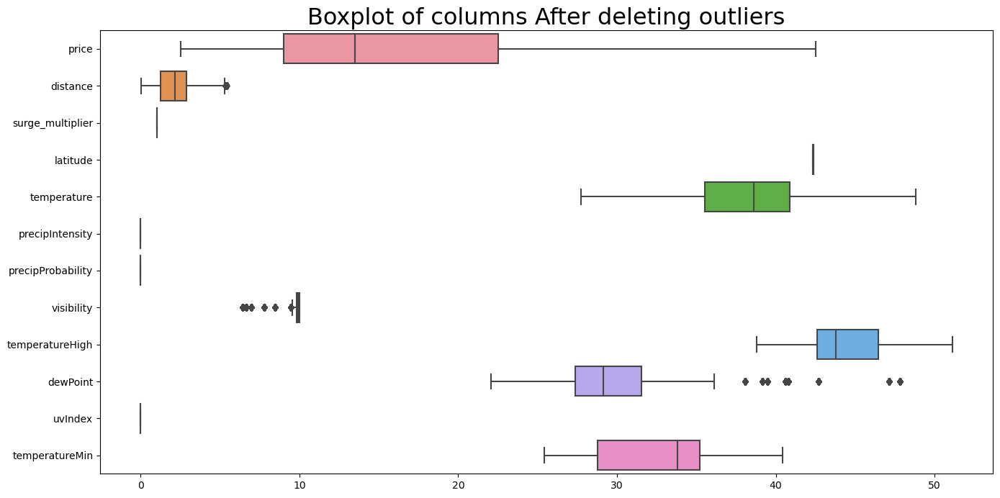

In [31]:
plt.figure(figsize=(16,8))
plt.title("Boxplot of columns After deleting outliers", fontsize = 23)
sns.boxplot(data=data[['price','distance','surge_multiplier','latitude','temperature','precipIntensity','precipProbability','visibility','temperatureHigh','dewPoint','uvIndex','temperatureMin']], orient="h")
plt.show()

In [32]:
data.shape

(216135, 38)

In [33]:
data.head()

,hour,day,month,datetime,source,destination,cab_type,name,price,distance,surge_multiplier,latitude,longitude,temperature,short_summary,long_summary,precipIntensity,precipProbability,humidity,windSpeed,windGustTime,visibility,temperatureHigh,temperatureLow,icon,dewPoint,pressure,windBearing,cloudCover,uvIndex,ozone,moonPhase,precipIntensityMax,temperatureMin,START_DATE,WEEKDAY,DAY_OF_WEEK,hourRange
11,19.0,28.0,11.0,2018-11-28 19:23:07,Back Bay,Northeastern University,Lyft,Lyft,7.0,1.08,1.0,42.3503,-71.0810,41.47,Overcast,Mostly cloudy throughout the day.,0.0,0.0,0.63,9.54,1.543432e+09,10.000,42.72,37.59,cloudy,29.72,991.85,295.0,1.00,0.0,354.2,0.72,0.0000,33.82,2018-11-28 19:23:07,Wednesday,2.0,16 - 19 pm
12,22.0,30.0,11.0,2018-11-30 22:13:01,North End,West End,Uber,UberXL,12.0,1.11,1.0,42.3647,-71.0542,40.13,Overcast,Mostly cloudy throughout the day.,0.0,0.0,0.60,3.38,1.543554e+09,9.833,42.52,31.71,cloudy,27.31,1017.16,281.0,1.00,0.0,281.8,0.79,0.0003,28.79,2018-11-30 22:13:01,Friday,4.0,20 - 23 pm
17,19.0,29.0,11.0,2018-11-29 19:18:00,North End,West End,Uber,UberPool,5.5,1.11,1.0,42.3647,-71.0542,43.49,Mostly Cloudy,Partly cloudy throughout the day.,0.0,0.0,0.52,12.13,1.543514e+09,9.796,44.61,28.79,partly-cloudy-day,26.83,1007.12,313.0,0.53,0.0,309.7,0.75,0.0000,35.35,2018-11-29 19:18:00,Thursday,3.0,16 - 19 pm
19,6.0,16.0,12.0,2018-12-16 06:15:11,North Station,Haymarket Square,Lyft,Lyft XL,11.0,0.72,1.0,42.3661,-71.0631,40.36,Clear,Rain throughout the day.,0.0,0.0,0.69,7.08,1.545016e+09,10.000,43.78,34.12,clear-night,30.94,1022.94,52.0,0.06,0.0,298.7,0.30,0.1246,38.94,2018-12-16 06:15:11,Sunday,6.0,4 - 7 am
20,19.0,27.0,11.0,2018-11-27 19:18:22,North Station,Haymarket Square,Lyft,Lux Black,16.5,0.72,1.0,42.3661,-71.0631,42.95,Mostly Cloudy,Light rain in the morning.,0.0,0.0,0.72,9.42,1.543338e+09,10.000,46.83,33.75,partly-cloudy-day,34.56,990.25,257.0,0.81,0.0,313.6,0.68,0.1433,36.13,2018-11-27 19:18:22,Tuesday,1.0,16 - 19 pm


<a id="16"></a>

--------
# <center><font size = 6><span style="color:#2a6592">Visualisation</span></font></center>


[back](#0)

1. [Distribution of Features](#17)
2. [Distribution of hourRange](#18)
3. [Percentage count of source](#19)
4. [The average price by distance](#20)
5. [Distubition of price in each cab_type](#21)
6. [Percentage count of categorical variables](#22)
7. [Number of trips vs months](#23)
8. [Number of trips vs days](#24)
9. [Number of trips vs days of december](#25)
10. [Distribution of trips per day](#26)
11. [Pickup points vs frequency](#27)
12. [End points vs frequency](#28)
13. [distribution of uber caps](#29)

<a id="17"></a>

**Distribution of Features**

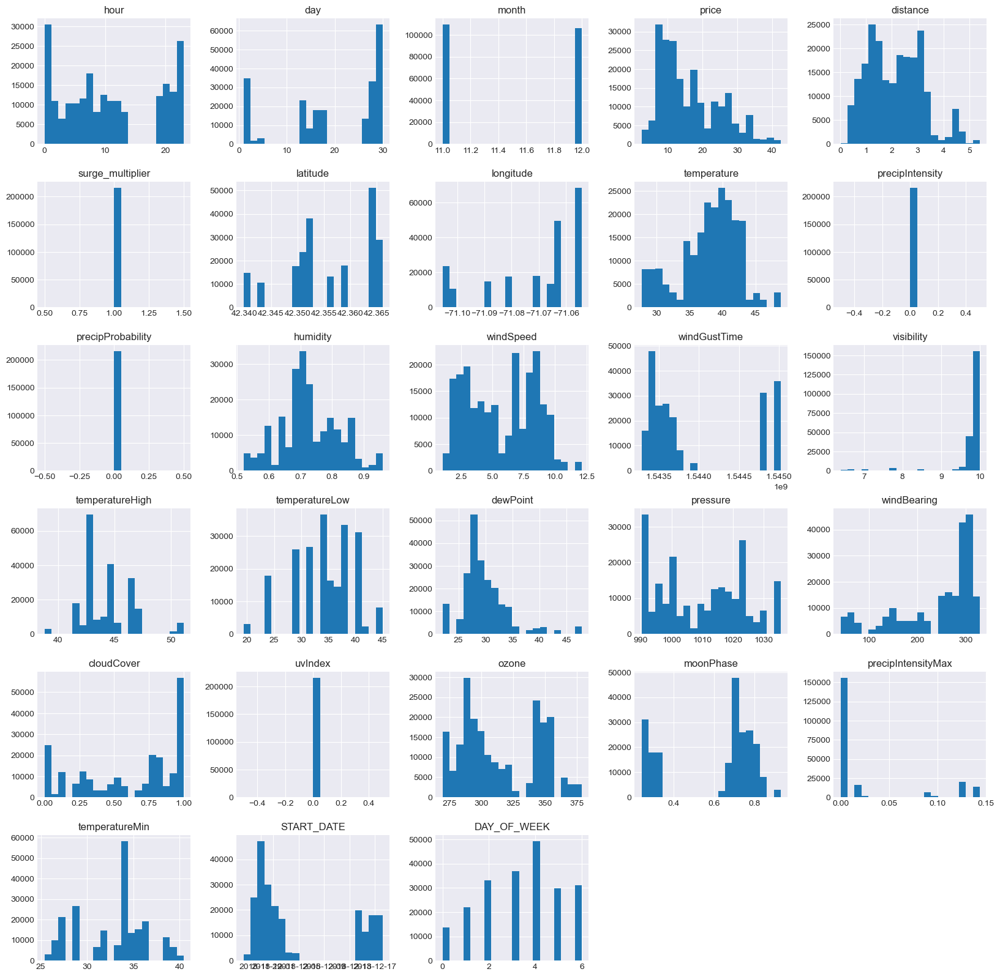

In [34]:
#Distribution of Features
style.use("seaborn-darkgrid")
data.hist(figsize=(20,20),bins=20);
plt.show()

*What hour do most people take uber to thier destination?*

<a id="18"></a>

**Distribution of hourRange**

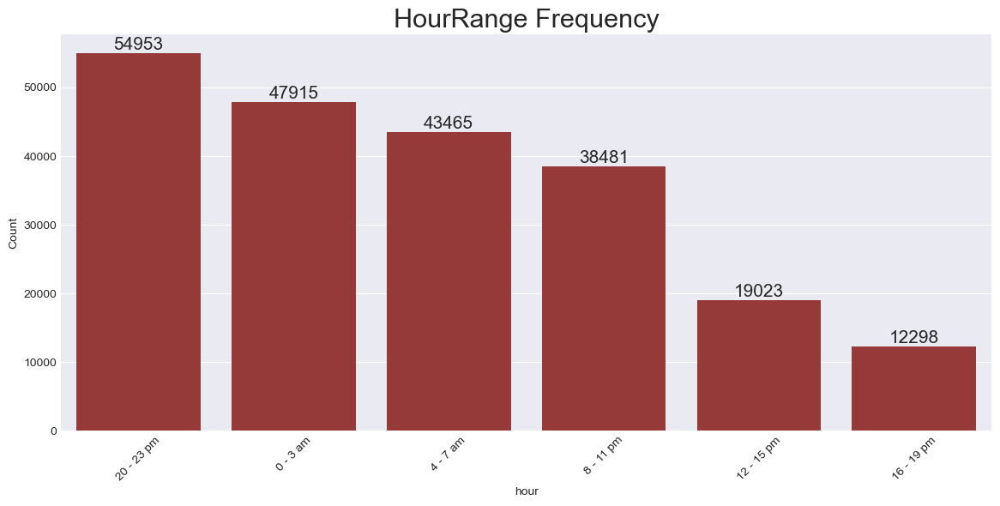

In [35]:
def top_rating_plot(df,column, n):
    #plotting graph
    plt.figure(figsize=(14,6))
    data = df[str(column)].value_counts().head(n)
    ax = sns.barplot(x = data.index, y = data, order= data.index, color='brown')
    for p in ax.patches:
        ax.text(p.get_x() + p.get_width()/2., p.get_height(), '%d' % int(p.get_height()), 
                fontsize=15, ha='center', va='bottom')
    plt.title('HourRange Frequency', fontsize=22)
    plt.xlabel('hour')
    plt.ylabel('Count')
    plt.xticks(rotation=45)
    plt.show()

top_rating_plot(data,'hourRange',10)

<a id="19"></a>

**Percentage count of source**

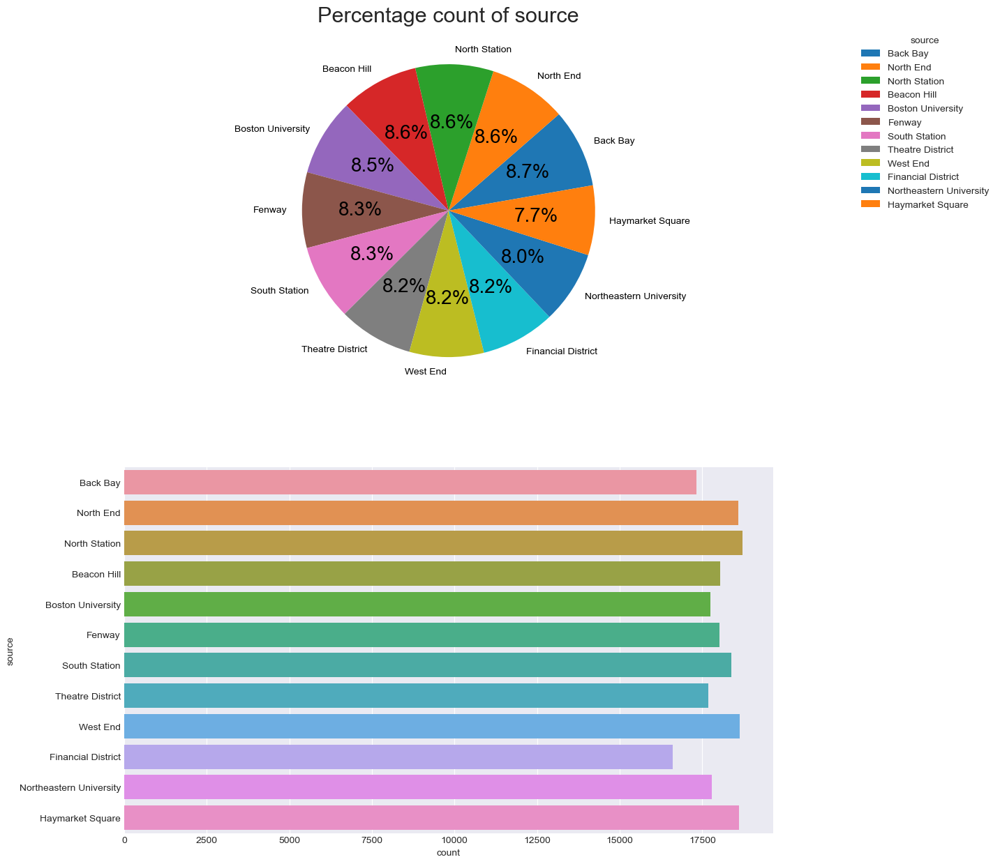

In [36]:
# creating lists for source and counts
src_freq = list(data['source'].value_counts())
src = list(data['source'].unique())

def func(pct, allvalues):
    absolute = int(pct / 100.*np.sum(allvalues))
    return "{:.1f}%".format(pct, absolute)
 
# Creating plot
fig, ax = plt.subplots(2, 1, figsize=(12, 15))
wedges, texts, autotexts = ax[0].pie(src_freq,
                                  autopct = lambda pct: func(pct, src_freq),
                                  labels = src,
                                  startangle = 10,
                                  textprops = dict(color ="black"))
# Adding legend
ax[0].legend(wedges, src,
          title ="source",
         loc='upper right', bbox_to_anchor=(2, 1))
 
plt.setp(autotexts, size = 20, weight ="light")
ax[0].set_title("Percentage count of source", fontdict={'fontsize':22})
sns.countplot(y='source', data=data,ax=ax[1])
# show plot
plt.show()

<a id="20"></a>

**The average price by distance**

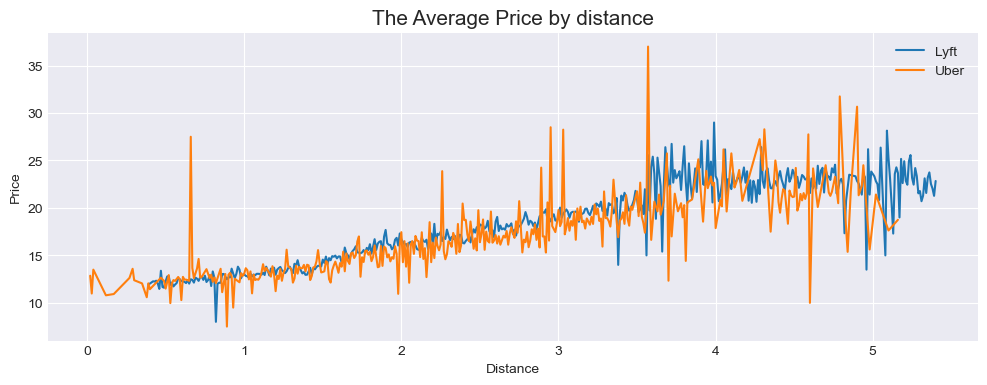

In [37]:
# The average price by distance
fig , ax = plt.subplots(figsize = (12,4))
ax.plot(data[data['cab_type'] == "Lyft"].groupby('distance').price.mean().index, data[data['cab_type'] == "Lyft"].groupby('distance')['price'].mean(), label = 'Lyft')
ax.plot(data[data['cab_type'] == "Uber"].groupby('distance').price.mean().index, data[data['cab_type'] =="Uber"].groupby('distance').price.mean(), label = 'Uber')
ax.set_title('The Average Price by distance', fontsize= 15)
ax.set(xlabel = 'Distance', ylabel = 'Price' )
ax.legend()
plt.show()

<a id="21"></a>

**Distubition of price in each cab_type**

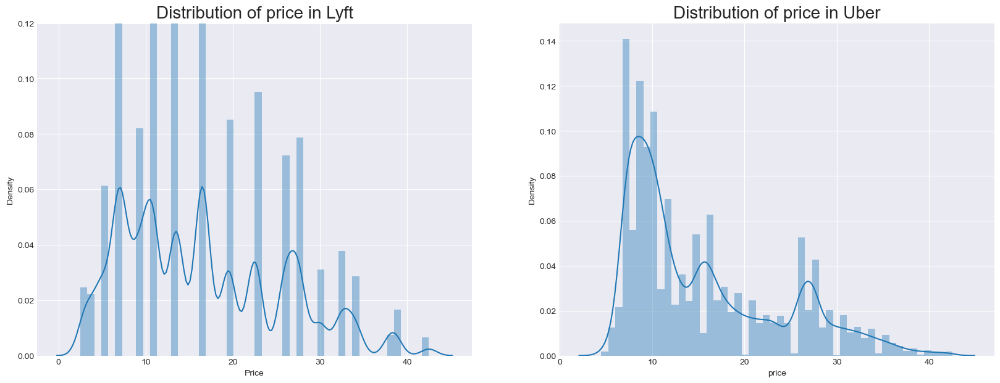

In [38]:
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(20, 7))
uber = data[data['cab_type']=='Uber']
lyft = data[data['cab_type']=='Lyft']
a = sns.distplot(lyft['price'], ax=ax1)
ax1.set_title('Distribution of price in Lyft', fontsize=20)
ax1.set(xlabel='Price')
ax1.set_ylim(0, 0.12)
b =sns.distplot(uber[~uber['price'].isnull()]['price'], ax=ax2)
ax2.set_title('Distribution of price in Uber', fontsize=20)
plt.show()

<a id="22"></a>

**Percentage count of categorical variables**

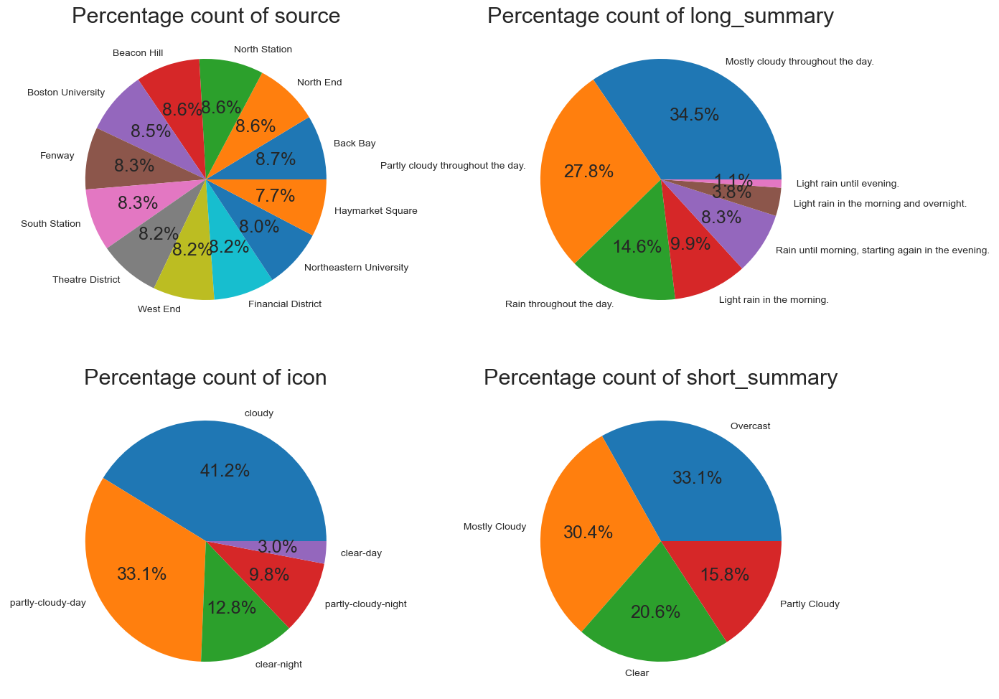

In [39]:
def func(pct, allvalues):
    absolute = int(pct / 100.*np.sum(allvalues))
    return "{:.1f}%".format(pct, absolute)
# Creating plot
fig, ax = plt.subplots(2, 2, figsize=(15, 12))
#source
src_freq = list(data['source'].value_counts())
src = list(data['source'].unique())
wedges, texts, autotexts = ax[0,0].pie(src_freq,
                                  autopct = lambda pct: func(pct, src_freq),
                                  labels = src)
plt.setp(autotexts, size = 18, weight ="light")
ax[0,0].set_title("Percentage count of source", fontdict={'fontsize':22})
#short_summary
src_freq = list(data['short_summary'].value_counts())
src = list(data['short_summary'].unique())
wedges, texts, autotexts = ax[1,1].pie(src_freq,
                                  autopct = lambda pct: func(pct, src_freq),
                                  labels = src)
plt.setp(autotexts, size = 18, weight ="light")
ax[1,1].set_title("Percentage count of short_summary", fontdict={'fontsize':22})
#long_summary
src_freq = list(data['long_summary'].value_counts())
src = list(data['long_summary'].unique())
wedges, texts, autotexts = ax[0,1].pie(src_freq,
                                  autopct = lambda pct: func(pct, src_freq),
                                  labels = src)
plt.setp(autotexts, size = 18, weight ="light")
ax[0,1].set_title("Percentage count of long_summary", fontdict={'fontsize':22})
#icon
src_freq = list(data['icon'].value_counts())
src = list(data['icon'].unique())
wedges, texts, autotexts = ax[1,0].pie(src_freq,
                                  autopct = lambda pct: func(pct, src_freq),
                                  labels = src)
plt.setp(autotexts, size = 18, weight ="light")
ax[1,0].set_title("Percentage count of icon", fontdict={'fontsize':22})
# show plot
plt.show()

<a id="23"></a>

**Number of trips vs months**

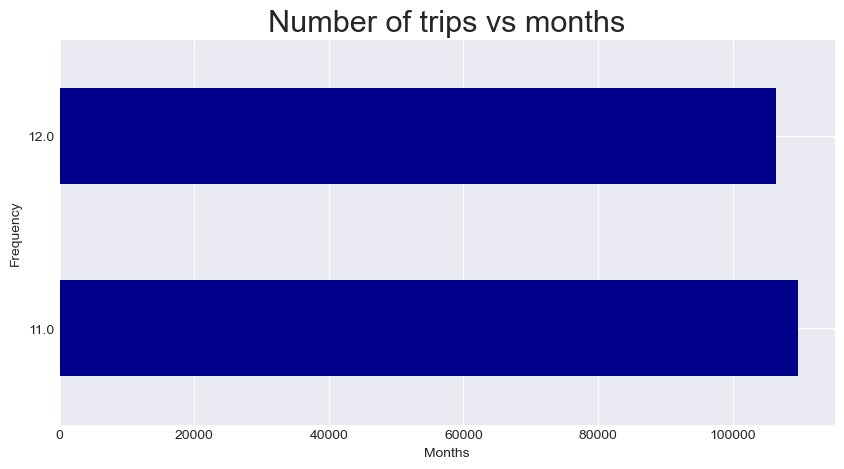

In [40]:
months=data['month'].value_counts()
months.plot(kind='barh', color='darkblue',figsize=(10,5))
plt.xlabel('Months')
plt.ylabel('Frequency')
plt.title('Number of trips vs months',fontsize=22)
plt.show()

What hour do most people take uber to thier destination

<a id="24"></a>

**Number of trips vs days**

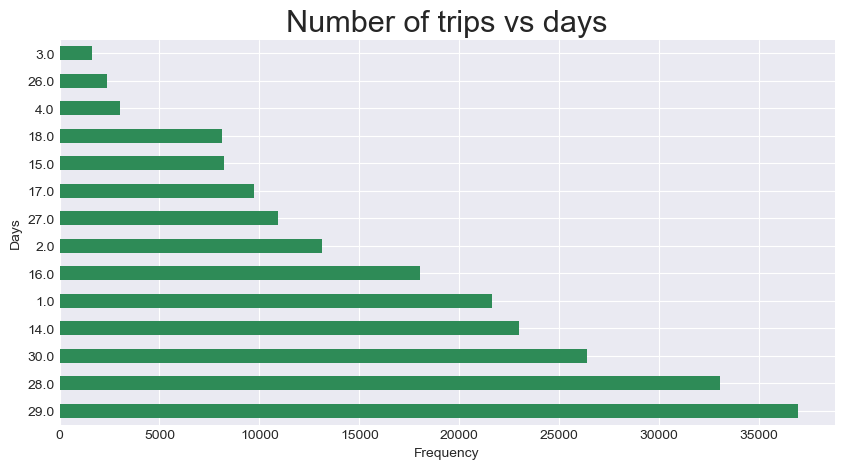

In [41]:
days=data['day'].value_counts()
days.plot(kind='barh', color='seagreen',figsize=(10,5))
plt.ylabel('Days')
plt.xlabel('Frequency')
plt.title('Number of trips vs days',fontsize=22)
plt.show()

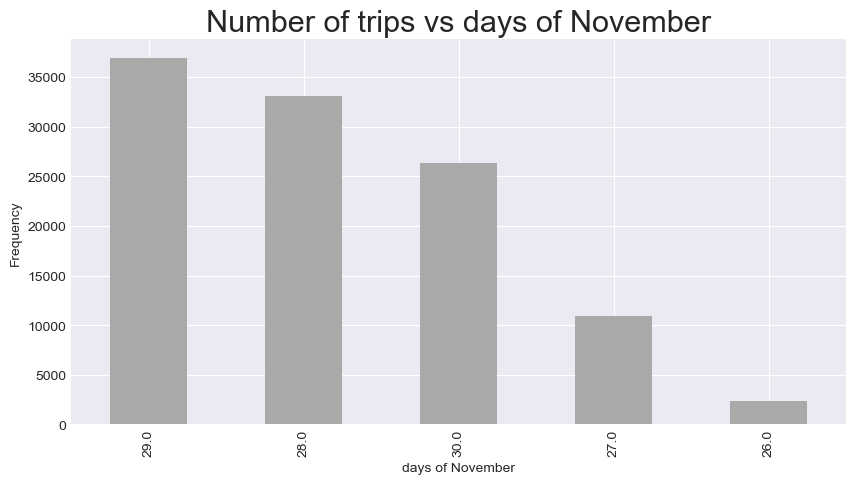

In [82]:
months=data['day'][data['month']==11].value_counts()
months.plot(kind='bar', color='darkgray',figsize=(10,5))
plt.xlabel('days of November')
plt.ylabel('Frequency')
plt.title('Number of trips vs days of November',fontsize=22)
plt.show()

<a id="25"></a>

**Number of trips vs days of december**

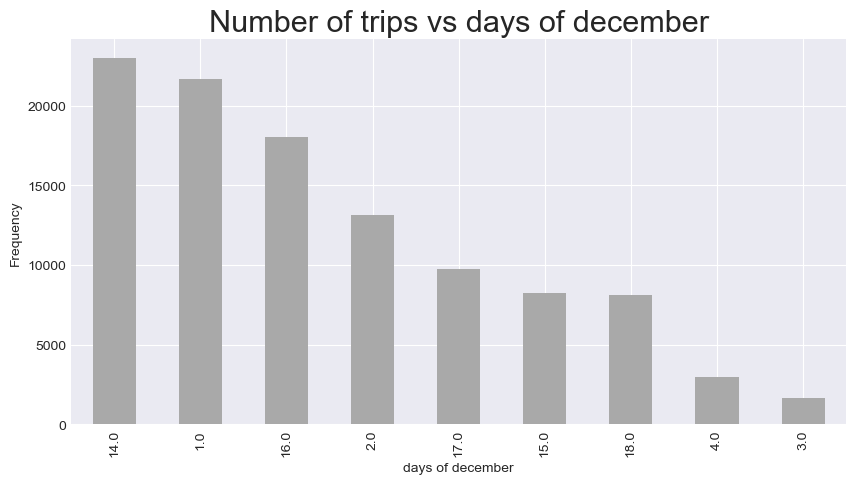

In [43]:
months=data['day'][data['month']==12].value_counts()
months.plot(kind='bar', color='darkgray',figsize=(10,5))
plt.xlabel('days of december')
plt.ylabel('Frequency')
plt.title('Number of trips vs days of december',fontsize=22)
plt.show()

Uber rides were not more frequent during the holiday season in Boston.

<a id="26"></a>

**Distribution of trips per day**

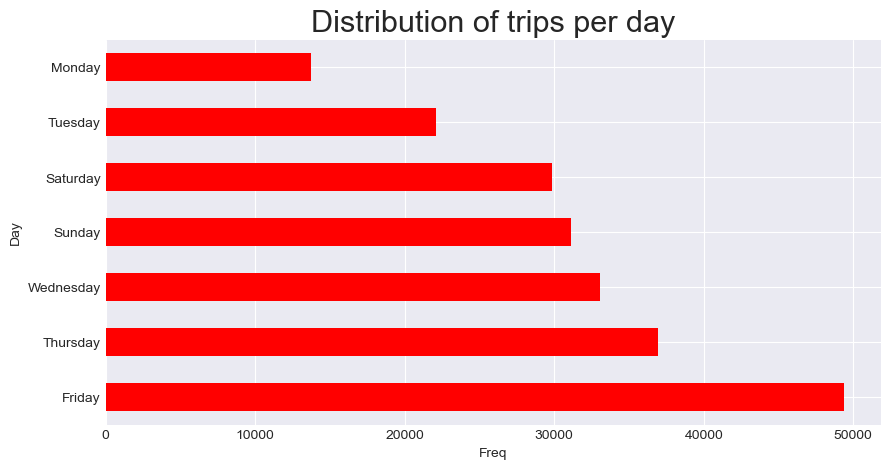

In [44]:
# To analyze the day of the week data, need to generate the names of days from the timestamp
day_week = [calendar.day_name[x.dayofweek] for x in 
            pd.to_datetime(data['datetime'], format='%Y/%m/%d %H:%M:%S')]
day_week=pd.Series(day_week)

days=day_week.value_counts()
days.plot(kind='barh',color='red', figsize=(10,5))
plt.xlabel('Freq')
plt.ylabel('Day')
plt.title('Distribution of trips per day',fontsize=22)
plt.show()

<a id="27"></a>

**Pickup points vs frequency**

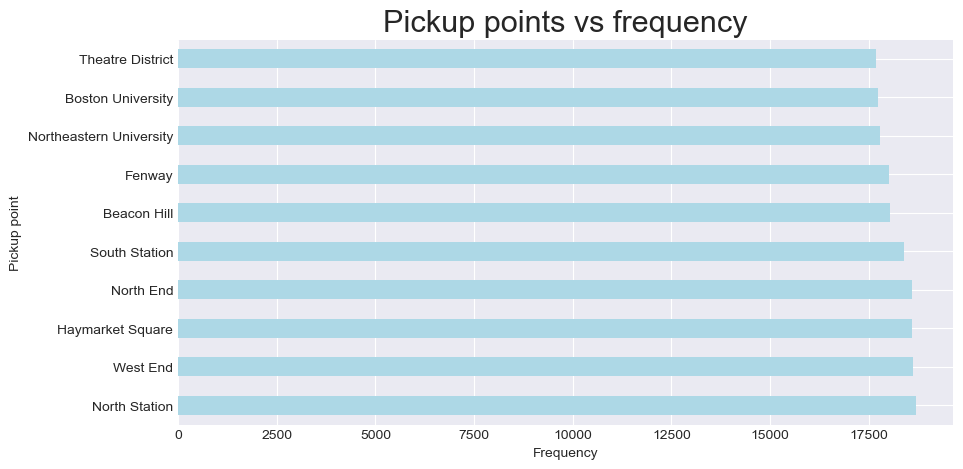

In [45]:
months=data['source'].value_counts().nlargest(10)
months.plot(kind='barh', color='lightblue',figsize=(10,5))
plt.xlabel('Frequency')
plt.ylabel('Pickup point')
plt.title('Pickup points vs frequency',fontsize=22)
plt.show()

There were no especially busy pickup or drop-off points in Boston, and most popular locations received a similar number of pick-up and drop-off requests. The Financial District (the business hub of Boston) received slightly more traffic than the rest – confirming the afternoon business meetings on Mondays and Tuesdays.

<a id="28"></a>

**End points vs frequency**

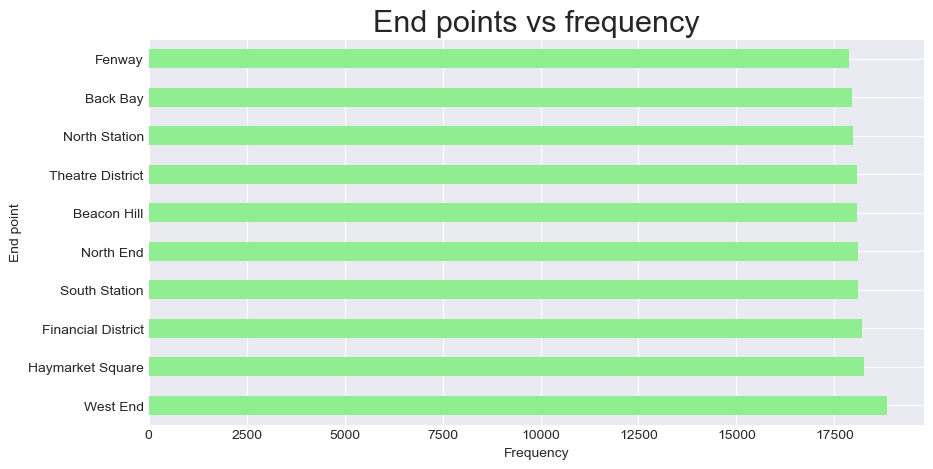

In [46]:
destination=data['destination'].value_counts().nlargest(10)
destination.plot(kind='barh', color='lightgreen',figsize=(10,5))
plt.xlabel('Frequency')
plt.ylabel('End point')
plt.title('End points vs frequency',fontsize=22)
plt.show()

Looking at the whole trip data, we find that most trips from and to the Financial District have the South Station on the other end. This means that people use Uber to reach the Metro more frequently than to reach their desired destination directly.

<a id="29"></a>

**distribution of uber caps**

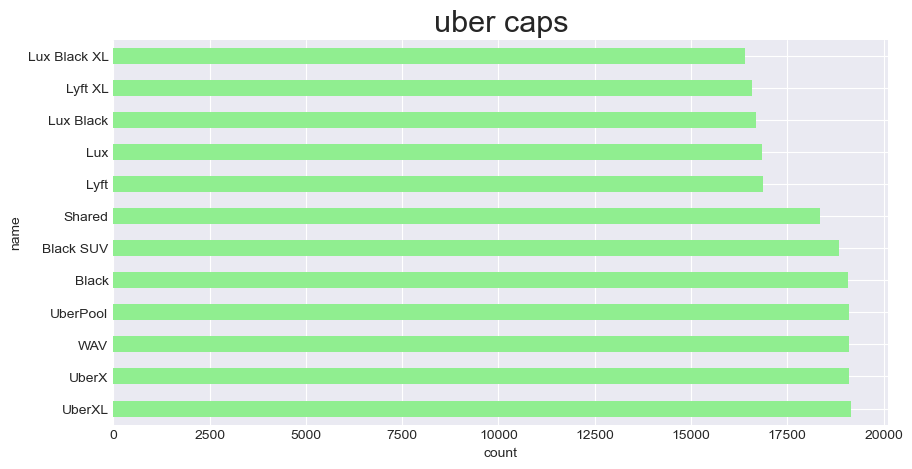

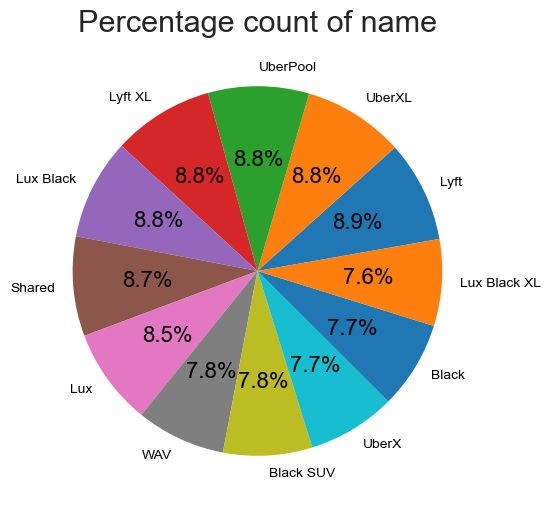

In [47]:
name=data['name'].value_counts()
name.plot(kind='barh', color='lightgreen',figsize=(10,5))
plt.xlabel('count')
plt.ylabel('name')
plt.title('uber caps',fontsize=22)
plt.show()
# creating lists for name and counts
name_freq = list(data['name'].value_counts())
name= list(data['name'].unique())


# Creating plot
fig, ax = plt.subplots(1, 1, figsize=(10, 6))
wedges, texts, autotexts = ax.pie(name_freq,
                                  autopct = lambda pct: func(pct, name_freq),
                                  labels = name,
                                  startangle = 10,
                                  textprops = dict(color ="black"))

plt.setp(autotexts, size = 16, weight ="light")
ax.set_title("Percentage count of name", fontdict={'fontsize':22})
# show plot
plt.show()

<a id="30"></a>

# Convert all categorical to numerical
[back to table of Contents](#0)

In [48]:
data.duplicated().sum()

0

In [49]:
data = data.drop(columns = ['datetime','START_DATE'])
#data=data.drop_duplicates()
numerical = data.select_dtypes(['int64', 'float64']).columns # getting the Uniqueness numerical variable
categorical = data.select_dtypes(['category', 'object']).columns # getting the Uniqueness catrgorical variable
categorical

Index(['source', 'destination', 'cab_type', 'name', 'short_summary',
       'long_summary', 'icon', 'WEEKDAY', 'hourRange'],
      dtype='object')

In [50]:
numerical

Index(['hour', 'day', 'month', 'price', 'distance', 'surge_multiplier',
       'latitude', 'longitude', 'temperature', 'precipIntensity',
       'precipProbability', 'humidity', 'windSpeed', 'windGustTime',
       'visibility', 'temperatureHigh', 'temperatureLow', 'dewPoint',
       'pressure', 'windBearing', 'cloudCover', 'uvIndex', 'ozone',
       'moonPhase', 'precipIntensityMax', 'temperatureMin', 'DAY_OF_WEEK'],
      dtype='object')

In [51]:
#data.drop(["ozone","temperatureMin","windBearing","pressure","dewPoint","uvIndex"
#          ,"temperatureLow","temperatureHigh"],
    #      axis = 1, inplace = True)


In [52]:
from sklearn import preprocessing
def encode_categorical(df,col):
    label_encoder=preprocessing.LabelEncoder()
    df[col]= label_encoder.fit_transform(df[col])
    print("class mapping of {}: ".format(col))
    for i, item in enumerate(label_encoder.classes_):
        print(item, '-->', i)
    print("--------------")
    return df


In [53]:
df=data.copy()
for col in categorical:
    df=encode_categorical(df,col)

class mapping of source: 
Back Bay --> 0
Beacon Hill --> 1
Boston University --> 2
Fenway --> 3
Financial District --> 4
Haymarket Square --> 5
North End --> 6
North Station --> 7
Northeastern University --> 8
South Station --> 9
Theatre District --> 10
West End --> 11
--------------
class mapping of destination: 
Back Bay --> 0
Beacon Hill --> 1
Boston University --> 2
Fenway --> 3
Financial District --> 4
Haymarket Square --> 5
North End --> 6
North Station --> 7
Northeastern University --> 8
South Station --> 9
Theatre District --> 10
West End --> 11
--------------
class mapping of cab_type: 
Lyft --> 0
Uber --> 1
--------------
class mapping of name: 
Black --> 0
Black SUV --> 1
Lux --> 2
Lux Black --> 3
Lux Black XL --> 4
Lyft --> 5
Lyft XL --> 6
Shared --> 7
UberPool --> 8
UberX --> 9
UberXL --> 10
WAV --> 11
--------------
class mapping of short_summary: 
 Clear  --> 0
 Mostly Cloudy  --> 1
 Overcast  --> 2
 Partly Cloudy  --> 3
--------------
class mapping of long_summary: 
 Li

In [54]:
df.head()

,hour,day,month,source,destination,cab_type,name,price,distance,surge_multiplier,latitude,longitude,temperature,short_summary,long_summary,precipIntensity,precipProbability,humidity,windSpeed,windGustTime,visibility,temperatureHigh,temperatureLow,icon,dewPoint,pressure,windBearing,cloudCover,uvIndex,ozone,moonPhase,precipIntensityMax,temperatureMin,WEEKDAY,DAY_OF_WEEK,hourRange
11,19.0,28.0,11.0,0,8,0,5,7.0,1.08,1.0,42.3503,-71.0810,41.47,2,3,0.0,0.0,0.63,9.54,1.543432e+09,10.000,42.72,37.59,2,29.72,991.85,295.0,1.00,0.0,354.2,0.72,0.0000,33.82,6,2.0,2
12,22.0,30.0,11.0,6,11,1,10,12.0,1.11,1.0,42.3647,-71.0542,40.13,2,3,0.0,0.0,0.60,3.38,1.543554e+09,9.833,42.52,31.71,2,27.31,1017.16,281.0,1.00,0.0,281.8,0.79,0.0003,28.79,0,4.0,3
17,19.0,29.0,11.0,6,11,1,8,5.5,1.11,1.0,42.3647,-71.0542,43.49,1,4,0.0,0.0,0.52,12.13,1.543514e+09,9.796,44.61,28.79,3,26.83,1007.12,313.0,0.53,0.0,309.7,0.75,0.0000,35.35,4,3.0,2
19,6.0,16.0,12.0,7,5,0,6,11.0,0.72,1.0,42.3661,-71.0631,40.36,0,5,0.0,0.0,0.69,7.08,1.545016e+09,10.000,43.78,34.12,1,30.94,1022.94,52.0,0.06,0.0,298.7,0.30,0.1246,38.94,3,6.0,4
20,19.0,27.0,11.0,7,5,0,3,16.5,0.72,1.0,42.3661,-71.0631,42.95,1,1,0.0,0.0,0.72,9.42,1.543338e+09,10.000,46.83,33.75,3,34.56,990.25,257.0,0.81,0.0,313.6,0.68,0.1433,36.13,5,1.0,2


<a id="31"></a>

--------
# <center><font size = 6><span style="color:#2a6592">Feature Selection</span></font></center>

* calculate mutual information

[back to table of Contents](#0)

In [55]:
x= df[df['cab_type']==1].drop(['price', 'cab_type'], axis=1)
y= df[df['cab_type']==1]['price']

In [56]:
from sklearn.model_selection import train_test_split

In [57]:
x_train, x_test, y_train, y_test=train_test_split(x,y, test_size=0.2, random_state=42)

In [58]:
from sklearn.preprocessing import StandardScaler

def encode_numerical(df,col):
    scaler = StandardScaler()
    df[col]= scaler.fit_transform(df[[col]])
    return df
#for col in numerical:
#    df=encode_numerical(df,col)

In [59]:
numerical=['hour', 'day', 'month', 'distance', 'surge_multiplier',
       'latitude', 'longitude', 'temperature', 'precipIntensity',
       'precipProbability', 'humidity', 'windSpeed', 'windGustTime',
       'visibility', 'temperatureHigh', 'temperatureLow', 'dewPoint',
       'pressure', 'windBearing', 'cloudCover', 'uvIndex', 'ozone',
       'moonPhase', 'precipIntensityMax', 'temperatureMin', 'DAY_OF_WEEK']
for col in numerical:
    x_train=encode_numerical(x_train,col)
def encode_numerical(df,col):
    scaler = StandardScaler()
    df[col]= scaler.fit(df[[col]])
    return df
for col in numerical:
    x_test=encode_numerical(x_test,col)
x_train

,hour,day,month,source,destination,name,distance,surge_multiplier,latitude,longitude,temperature,short_summary,long_summary,precipIntensity,precipProbability,humidity,windSpeed,windGustTime,visibility,temperatureHigh,temperatureLow,icon,dewPoint,pressure,windBearing,cloudCover,uvIndex,ozone,moonPhase,precipIntensityMax,temperatureMin,WEEKDAY,DAY_OF_WEEK,hourRange
430052,1.069097,0.897592,-0.981315,3,11,10,0.589694,0.0,1.052314,0.972158,1.230401,1,4,0.0,0.0,-2.247573,2.394165,-0.666112,0.019769,0.169233,-1.008310,3,-0.702397,-0.211125,0.874953,-0.239663,0.0,-0.162562,0.610615,-0.522616,0.690663,4,-0.219327,2
597381,-0.864403,0.897592,-0.981315,9,7,8,0.261398,0.0,-0.507519,0.920306,0.030790,1,3,0.0,0.0,-0.283096,1.045382,-0.790454,0.401285,-0.722286,0.545409,4,-0.162904,-0.824283,0.748525,-0.071154,0.0,1.062592,0.478507,-0.522616,0.246439,4,-0.219327,4
200552,-0.219903,-1.811050,1.019041,0,2,1,-0.694524,0.0,-1.604276,-1.683777,-1.394737,1,0,0.0,0.0,1.026556,-0.609773,-0.428239,-0.184080,0.262376,0.043270,4,-0.664867,0.725095,0.862311,-0.267747,0.0,-1.049970,0.918868,-0.522616,-0.450858,2,0.924063,5
588345,-0.091003,0.897592,-0.981315,3,10,10,0.531759,0.0,-0.507519,0.390272,-0.027948,3,4,0.0,0.0,-0.610509,0.892196,-0.666112,0.391934,0.253505,-1.024684,4,-0.460798,-0.467523,0.786454,-1.110292,0.0,0.877163,0.610615,-0.522616,0.601818,4,-0.219327,5
273784,-1.251103,0.994329,-0.981315,5,7,9,-1.534576,0.0,-0.678126,-1.977601,-0.021171,0,4,0.0,0.0,-0.828784,0.604505,-0.666112,0.371362,0.324472,-1.075626,1,-0.615609,0.121460,0.938168,-1.728158,0.0,-0.553286,0.610615,-0.522616,0.650279,0,0.352368,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
466274,-1.380003,-0.456729,1.019041,9,4,0,-1.428362,0.0,-0.678126,-1.977601,0.803420,2,4,0.0,0.0,0.917418,-0.703179,1.334178,-0.032596,1.096235,1.200372,2,1.481376,1.274520,-0.768615,0.771390,0.0,-0.811562,-1.635225,-0.522616,-1.689299,2,0.924063,0
668325,1.326896,-0.553466,1.019041,10,2,0,0.493136,0.0,-1.982049,-1.044279,1.099370,1,4,0.0,0.0,-0.719647,-0.923617,1.334178,-0.402891,1.184943,1.167624,4,0.590040,1.399056,-0.730686,0.322034,0.0,-0.808250,-1.635225,-0.522616,-1.621993,0,0.352368,3
629649,-0.348803,0.994329,-0.981315,6,7,1,-1.042132,0.0,-0.507519,0.920306,-1.796867,0,3,0.0,0.0,1.353969,-1.297242,-0.606644,0.146941,-0.686803,-0.515268,1,-0.840789,0.351486,0.799096,-1.728158,0.0,-0.973812,0.786759,-0.514513,-1.078155,0,0.352368,5
5264,1.069097,0.897592,-0.981315,7,2,10,0.869711,0.0,1.052314,0.972158,1.230401,1,4,0.0,0.0,-2.247573,2.394165,-0.666112,0.019769,0.169233,-1.008310,3,-0.702397,-0.211125,0.874953,-0.239663,0.0,-0.162562,0.610615,-0.522616,0.690663,4,-0.219327,2


In [60]:
from sklearn.feature_selection import VarianceThreshold
selector = VarianceThreshold(threshold=0.2)
selector.fit(x_train)

VarianceThreshold(threshold=0.2)

In [61]:
selector.get_support()

array([ True,  True,  True,  True,  True,  True,  True, False,  True,
        True,  True,  True,  True, False, False,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True, False,
        True,  True,  True,  True,  True,  True,  True])

In [62]:
from sklearn.feature_selection import mutual_info_regression
# determine the mutual information
mutual_info = mutual_info_regression(x_train, y_train)
mutual_info

array([2.83201956e-03, 3.72962020e-03, 2.87668233e-03, 1.02003067e-01,
       9.76187179e-02, 9.02808198e-01, 4.92493153e-01, 0.00000000e+00,
       1.90397424e-04, 0.00000000e+00, 3.10080518e-03, 0.00000000e+00,
       0.00000000e+00, 2.42253159e-03, 6.41851096e-04, 1.96985546e-03,
       4.39831163e-04, 2.82088961e-03, 3.06918216e-03, 2.01228505e-03,
       2.30210451e-03, 1.38306611e-03, 3.52369464e-03, 3.02603346e-03,
       0.00000000e+00, 3.92712684e-04, 1.28507519e-03, 3.47389575e-03,
       2.28144100e-03, 6.73707627e-03, 4.41900809e-03, 0.00000000e+00,
       3.76461565e-03, 0.00000000e+00])

In [63]:
mutual_info = pd.Series(mutual_info)
mutual_info.index = x_train.columns
mutual_info.sort_values(ascending=False)

name                  0.902808
distance              0.492493
source                0.102003
destination           0.097619
precipIntensityMax    0.006737
temperatureMin        0.004419
DAY_OF_WEEK           0.003765
day                   0.003730
dewPoint              0.003524
ozone                 0.003474
temperature           0.003101
visibility            0.003069
pressure              0.003026
month                 0.002877
hour                  0.002832
windGustTime          0.002821
precipIntensity       0.002423
temperatureLow        0.002302
moonPhase             0.002281
temperatureHigh       0.002012
humidity              0.001970
icon                  0.001383
uvIndex               0.001285
precipProbability     0.000642
windSpeed             0.000440
cloudCover            0.000393
latitude              0.000190
windBearing           0.000000
short_summary         0.000000
long_summary          0.000000
longitude             0.000000
WEEKDAY               0.000000
surge_mu

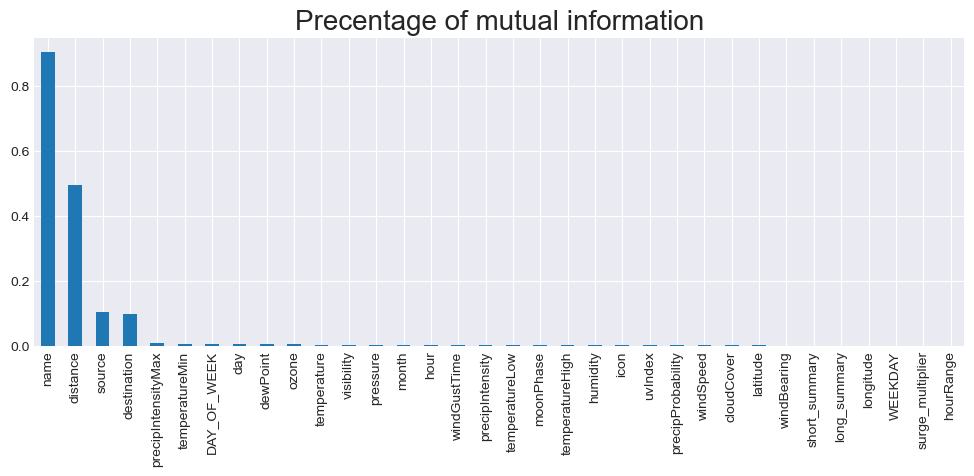

In [64]:
plt.title("Precentage of mutual information", fontsize = 20)
mutual_info.sort_values(ascending=False).plot.bar(figsize=(12,4))
plt.show()

In [65]:
from sklearn.feature_selection import SelectPercentile
## Selecting the top 20 percentile
selected_top_columns = SelectPercentile(mutual_info_regression, percentile=20 )
selected_top_columns.fit(x_train, y_train)

SelectPercentile(percentile=20,
                 score_func=<function mutual_info_regression at 0x000002274911CA60>)

In [66]:
x_train.columns[selected_top_columns.get_support()]

Index(['source', 'destination', 'name', 'distance', 'icon', 'dewPoint',
       'pressure'],
      dtype='object')

In [67]:
x1=x[x_train.columns[selected_top_columns.get_support()]]
x1.columns

Index(['source', 'destination', 'name', 'distance', 'icon', 'dewPoint',
       'pressure'],
      dtype='object')

In [68]:
x1.head()

,source,destination,name,distance,icon,dewPoint,pressure
12,6,11,10,1.11,2,27.31,1017.16
17,6,11,8,1.11,3,26.83,1007.12
25,1,9,11,2.48,3,31.96,999.80
29,1,9,8,2.48,2,31.63,1000.26
30,1,9,1,2.48,3,30.89,1029.37


<a id="32"></a>

----

# <center><font size = 6><span style="color:#2a6592">Dimension Reduction</span></font></center>

[back to table of Contents](#0)

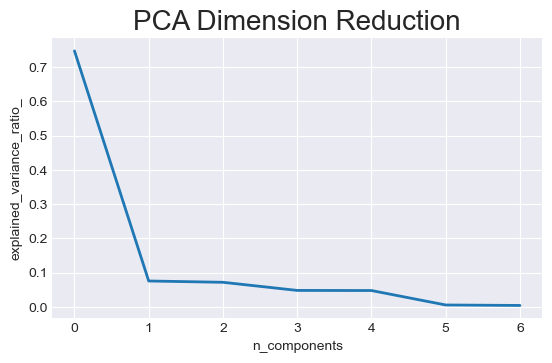

In [69]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
#scaler=StandardScaler()
#X_scaler =scaler.fit_transform(X)
from sklearn.decomposition import PCA
pca = PCA(n_components=None)
pca.fit(x1)
X_pca=pca.fit_transform(x1)
plt.figure(1, figsize=(7, 4))
plt.clf()
plt.axes([.2, .2, .7, .7])
plt.plot(pca.explained_variance_ratio_, linewidth=2)
plt.axis('tight')
plt.xlabel('n_components')
plt.ylabel('explained_variance_ratio_')
plt.title("PCA Dimension Reduction", fontsize = 20)
plt.show()

In [70]:
print('PCAModel Explained Variance ratio is : ' , pca.explained_variance_ratio_)
print('PCAModel singular value is : ' , pca.singular_values_)
print('PCAModel mean is : ' , pca.mean_)

PCAModel Explained Variance ratio is :  [0.74719205 0.07556469 0.07177057 0.04804837 0.04771256 0.00554349
 0.00416827]
PCAModel singular value is :  [4621.80858748 1469.78995862 1432.41557561 1172.02037568 1167.91755747
  398.09585388  345.20228393]
PCAModel mean is :  [   5.52166958    5.55229021    6.51522727    2.10906486    2.73736888
   29.81915079 1009.99306976]


In [71]:
pca.explained_variance_ratio_[:5].sum()

0.9902882370513941

In [72]:
pca.explained_variance_ratio_[:3].sum()

0.8945273086292087

In [81]:
pca.explained_variance_ratio_[:2].sum()

0.8227567375138579

In [73]:
df_pca= pd.DataFrame(X_pca)
df_pca.head()

,0,1,2,3,4,5,6
0,7.267173,-3.478453,-2.291017,-2.659689,4.799285,0.654922,-0.745885
1,-2.764800,-1.466262,-3.124496,-2.707401,4.787066,-0.148453,-0.736866
2,-10.250691,-4.504004,1.860215,-5.659284,0.347769,-0.141200,0.377314
3,-9.760431,-1.505214,1.583296,-5.674448,0.334194,0.863877,0.366120
4,19.343486,5.469432,1.783109,-5.627964,0.271963,-0.622079,0.411221


In [74]:
total_var = pca.explained_variance_ratio_[:3].sum() * 100
import plotly.express as px
fig = px.scatter_3d(
    X_pca[:,:3], x=0, y=1, z=2,
    title=f'Total Explained Variance: {total_var:.2f}%',
    labels={'0': 'PC 1', '1': 'PC 2', '2': 'PC 3'}
)
fig.show()

<a id="33"></a>

------

# <center><font size = 6><span style="color:#2a6592">Modeling</span></font></center>

[back to table of Contents](#0)

In [75]:
from sklearn.feature_selection import RFE   #Recurrsive feature elimination
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn import ensemble
from sklearn import metrics
import xgboost as xgb
from sklearn.metrics import r2_score

In [76]:
def train_test_models(x_train, y_train, x_test, y_test):
    print('Linear Regression')
    lr_model=LinearRegression()
    lr_model=lr_model.fit(x_train,y_train)
    y_pred = lr_model.predict(x_test)
    print('- Test Score is : ' , lr_model.score(x_test, y_test))
    print('- r2 Score is : ' , r2_score( y_pred,y_test))
    
    print('\nDecision Tree')
    dt_model=DecisionTreeRegressor(random_state=0,max_depth=10)
    dt_model.fit(x_train,y_train)
    y_pred = dt_model.predict(x_test)
    print('- Test Score is : ' , dt_model.score(x_test, y_test))
    print('- r2 Score is : ' , r2_score( y_pred,y_test))

    print('\nRandom Forest')
    random_forest=RandomForestRegressor(n_estimators=10, random_state=0)
    random_forest.fit(x_train,y_train)
    y_pred = random_forest.predict(x_test)
    print('- Test Score is : ' , random_forest.score(x_test, y_test))
    print('- r2 Score is : ' , r2_score( y_pred,y_test))

    print('\nGBM')
    gbm=ensemble.GradientBoostingRegressor(n_estimators=200, max_depth=5,random_state=0)
    gbm.fit(x_train,y_train) 
    print('- Test Score is : ' , gbm.score(x_test, y_test))
    y_pred = gbm.predict(x_test)
    print('- r2 Score is : ' , r2_score( y_pred,y_test))

    print('\nXGBoost')
    xgb_model = xgb.XGBRegressor(objective="reg:linear", random_state=0) 
    xgb_model.fit(x_train,y_train) 
    print('- Test Score is : ' , xgb_model.score(x_test, y_test))
    y_pred = xgb_model.predict(x_test)
    print('- r2 Score is : ' , r2_score( y_pred,y_test))

    return(lr_model, dt_model, random_forest, gbm,xgb_model)   

In [77]:
from sklearn.model_selection import train_test_split

In [78]:
x_train, x_test, y_train, y_test=train_test_split(x1,y, test_size=0.2, random_state=42)

model_list= train_test_models(x_train, y_train, x_test, y_test)

Linear Regression
- Test Score is :  0.6462121513396846
- r2 Score is :  0.46171173114259567

Decision Tree
- Test Score is :  0.9513166781486373
- r2 Score is :  0.9494869720433539

Random Forest
- Test Score is :  0.9394365540982944
- r2 Score is :  0.937917218569154

GBM
- Test Score is :  0.9550949441527564
- r2 Score is :  0.9530963608711331

XGBoost
[21:44:44] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:213: reg:linear is now deprecated in favor of reg:squarederror.
- Test Score is :  0.9561282656548326
- r2 Score is :  0.9543215642409202


In [79]:
x_train, x_test, y_train, y_test=train_test_split(X_pca[:,:5],y, test_size=0.2, random_state=42)

model_list= train_test_models(x_train, y_train, x_test, y_test)

Linear Regression
- Test Score is :  0.5558856198398713
- r2 Score is :  0.21755543714838455

Decision Tree
- Test Score is :  0.9347202234858397
- r2 Score is :  0.93115956691335

Random Forest
- Test Score is :  0.9357036986918055
- r2 Score is :  0.9340871033049298

GBM
- Test Score is :  0.9444064104253705
- r2 Score is :  0.9406154417506105

XGBoost
[21:45:35] WARNING: C:/buildkite-agent/builds/buildkite-windows-cpu-autoscaling-group-i-08de971ced8a8cdc6-1/xgboost/xgboost-ci-windows/src/objective/regression_obj.cu:213: reg:linear is now deprecated in favor of reg:squarederror.
- Test Score is :  0.9472181554882602
- r2 Score is :  0.9443734939124215
